In [1]:
pip install pandas numpy scipy matplotlib seaborn pyroomacoustics ipympl statsmodels

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 11.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.6/511.6 kB 16.0 MB/s eta 0:00:00
  Using cached pybind11-2.11.1-py3-none-any.whl (227 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 39.6 MB/s eta 0:00:00
  Created wheel for pyroomacoustics: filename=pyroomacoustics-0.7.3-cp310-cp310-linux_x86_64.whl size=11864137 sha256=919a166f5780d2e5b16a22965f850a28a81d16df77705d5d0a47fa5a8d8b05ec
  Stored in directory: /root/.cache/pip/wheels/6b/f3/67/0d0c4c06234c59c14e5ccf72774bd5c5f1b43c3083043c7fb7
Successfully built pyroomacoustics


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.signal as sp
import scipy.linalg as linalg
import scipy.io as io
import helper as hp
import importlib
import pyroomacoustics as pra
from numpy.fft import fft, rfft
from numpy.fft import fftshift, fftfreq, rfftfreq
from IPython.display import Audio, update_display
from ipywidgets import IntProgress
from statsmodels.tsa.stattools import pacf, acf
from statsmodels.tsa.ar_model import AutoReg, ar_select_order
%load_ext autoreload
%autoreload 2

In [4]:
try:
  import google.colab
  !git clone https://github.com/GonzaLinares/PASA_Proyecto2
  IN_COLAB = True
except:
  IN_COLAB = False

fatal: destination path 'PASA_Proyecto2' already exists and is not an empty directory.


<img src="https://imgur.com/AvqszhU.png">

# Importo respuestas impulsivas de BOSE QC20

Estaria bueno explicar un poco la composicion del database este. Dejo el link https://pub.dega-akustik.de/ICA2019/data/articles/000741.pdf

Tambien estaria bueno describir lo que se usa: el camino P y S, describir el orden y puede ser algun espectro para mostrar la respuesta en freq.

In [ ]:
if IN_COLAB:
  elecBackITA = io.loadmat("./PASA_Proyecto2/PANDAR_database_1.0/BoseQC20/electronic_backend/PANDAR_TF_201_backend_dSPACE.ita")
  acousticPathsITA = io.loadmat("./PASA_Proyecto2/PANDAR_database_1.0/BoseQC20/acoustic_booth/persons/PANDAR_TF_001_person_BoseQC20.ita")
else:
  elecBackITA = io.loadmat("./PANDAR_database_1.0/BoseQC20/electronic_backend/PANDAR_TF_201_backend_dSPACE.ita")
  acousticPathsITA = io.loadmat("./PANDAR_database_1.0/BoseQC20/acoustic_booth/persons/PANDAR_TF_001_person_BoseQC20.ita")


fs = 48000

In [ ]:
elecBack = elecBackITA['ITA_TOOLBOX_AUDIO_OBJECT'][0][0][14].T        # Direct, Lowcut, AAF, PreAmp En este orden estan las resp impulsivas

display(elecBackITA['ITA_TOOLBOX_AUDIO_OBJECT'][0][0][16])
display(elecBack.shape)

array([[array(['Direct'], dtype='<U6')],
       [array(['LowCut'], dtype='<U6')],
       [array(['AAF'], dtype='<U3')],
       [array(['Preamp'], dtype='<U6')]], dtype=object)

(4, 8192)

In [ ]:
acousticPaths = acousticPathsITA['ITA_TOOLBOX_AUDIO_OBJECT'][0][0][14].T   # SecL, SecR, FeedBL, FeedBR, primL, PrimR

acousticPathsITA['ITA_TOOLBOX_AUDIO_OBJECT'][0][0][16]

array([[array(['SecondaryL'], dtype='<U10')],
       [array(['SecondaryR'], dtype='<U10')],
       [array(['FeedbackL'], dtype='<U9')],
       [array(['FeedbackR'], dtype='<U9')],
       [array(['PrimaryL'], dtype='<U8')],
       [array(['PrimaryR'], dtype='<U8')]], dtype=object)

<img src="https://i.imgur.com/Lpvgzg9.png">

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


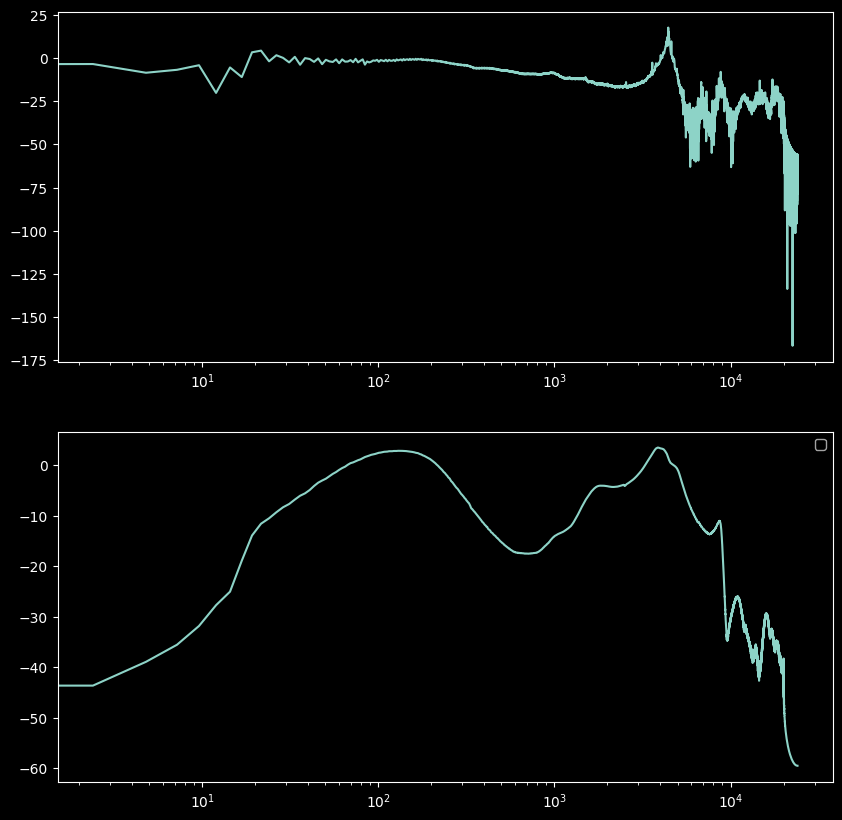

In [ ]:
plt.figure(figsize=(10, 10))

freqPp, Pp = sp.freqz(acousticPaths[4], [1], fs=48000, worN=10000)
freqPs, Ps = sp.freqz(acousticPaths[0], [1], fs=48000, worN=10000)
plt.subplot(211)
plt.semilogx(freqPp, 20*np.log10(np.abs(Pp)))
plt.subplot(212)
plt.semilogx(freqPs, 20*np.log10(np.abs(Ps)))
plt.legend()

# Genero el aparato experimental simulado

Esto hay que explicarlo. En la generacion se uso Pyroom con el metodo de imagen de fuente y ademas raytracing. Se simularon por lo menos 3 ordenes de reflejos, y el material usado fue el rough concrete, que esta en Pyroom.
Hay que describir el cuartucho este, y presentar las respuestas simuladas y el orden.

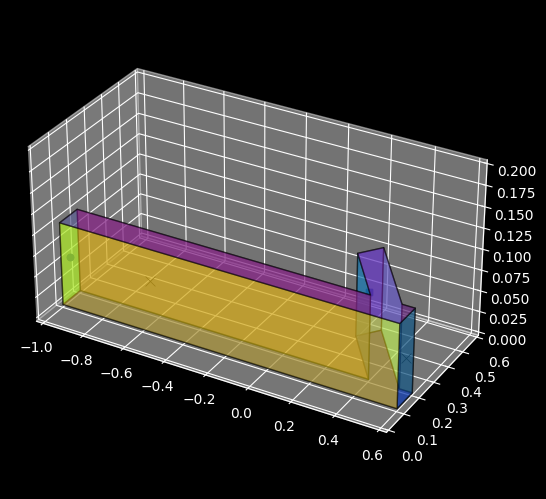

In [ ]:
room = hp.createRoom(print=True)

<img src="https://imgur.com/X6lTncP.png">

(<Figure size 640x480 with 4 Axes>,
 array([[<Axes: title={'center': 'Source 0'}>,
         <Axes: title={'center': 'Source 1'}>],
        [<Axes: xlabel='Time (ms)'>, <Axes: xlabel='Time (ms)'>]],
       dtype=object))

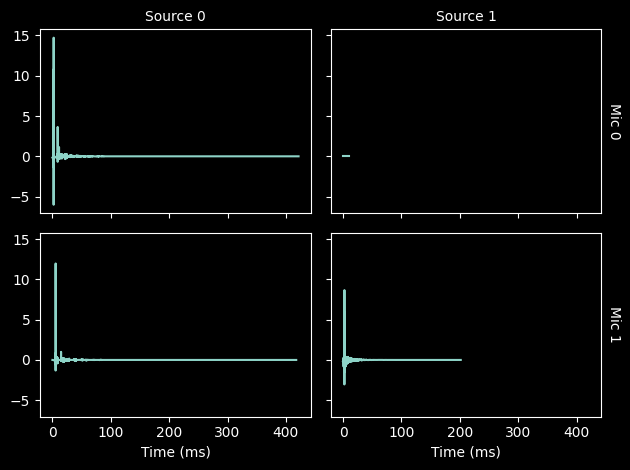

In [ ]:
room.plot_rir()

In [ ]:
Proom = hp.getProomImpulse()[0][0]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


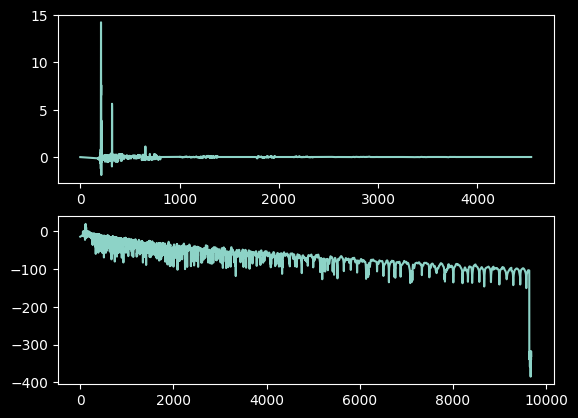

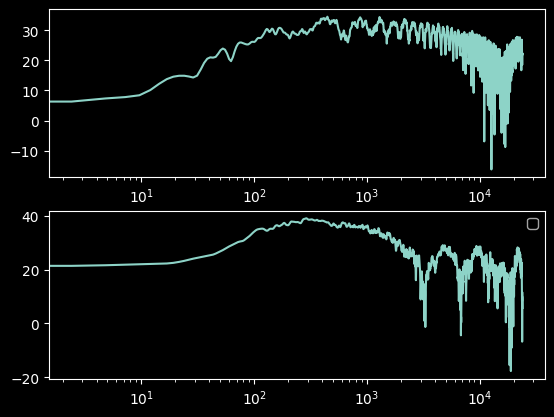

In [ ]:
room.rir # dim = (mic_n, source_n) -> P = []
Sroom = room.rir[1][1]

rt60_time_P = pra.measure_rt60(Proom)

Proom = Proom[:int(rt60_time_P)]

rt60_time_P = pra.measure_rt60(Sroom)

Proom = Proom[:int(rt60_time_P)]
plt.figure()
plt.subplot(211)
plt.plot(Proom)
plt.subplot(212)
plt.plot(20*np.log10(np.abs(Sroom)))

plt.figure()

freqPp, Pp = sp.freqz(Proom, [1], fs=48000, worN=10000)
freqPs, Ps = sp.freqz(Sroom, [1], fs=48000, worN=10000)
plt.subplot(211)
plt.semilogx(freqPp, 20*np.log10(np.abs(Pp)))
plt.subplot(212)
plt.semilogx(freqPs, 20*np.log10(np.abs(Ps)))
plt.legend()

# Importo Algunas muestras de audio para utilizar como señal para querer escuchar

In [ ]:
if IN_COLAB:
  _, Voice = io.wavfile.read("./PASA_Proyecto2/Voice.wav")
  _, Song = io.wavfile.read("./PASA_Proyecto2/Song.wav")
else:
  _, Voice = io.wavfile.read("Voice.wav")
  _, Song = io.wavfile.read("Song.wav")

Song = Song.T


/tmp/ipykernel_10290/2030395732.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, Voice = io.wavfile.read("Voice.wav")
/tmp/ipykernel_10290/2030395732.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, Song = io.wavfile.read("Song.wav")


# Importo algunos sonidos para utilizar como interferencias

In [ ]:
if IN_COLAB:
  _, Street = io.wavfile.read("./PASA_Proyecto2/ruidoCalle.wav")
else:
  _, Street = io.wavfile.read("ruidoCalle.wav")
Street = Street.T

/tmp/ipykernel_10290/3147760954.py:1: WavFileWarning: Chunk (non-data) not understood, skipping it.
  _, Street = io.wavfile.read("ruidoCalle.wav")


# Demos de FX-NLMS

Prueba preliminar para probar experimentalmente la cota del mu que permite la convergencia. Esto que sigue es el Mu optimo(Eq 84 de Theoretical convergence analysis of FxLMS algorithm.):

$$\frac{1}{E(X_f * X_f)*(M + 2 \Delta_{eq})}$$

M es el orden del filtro adaptativo

$$\Delta_{eq} = \frac{\tau_s^2}{\sigma_s^2}$$

$$\tau_s^2 = \sum_{k=0}^{Q-1} k*s_k^2$$
$$\sigma_s^2 = \sum_{k=0}^{Q-1} s_k^2$$
 s son los coeficientes del filtro S


El delta eq es el delay equivalente del camino secundario.

Este resultado esta generalizado para X ruido blanco y S un camino que se modela con un FIR.

Este valor optimo anda justo, lo calcule y si le pones un cachito mas ya diverge.
Estaria bueno probar en otros ejemplos para comprobar.

In [ ]:
x = lambda n: np.random.normal(0, 1, size=n if isinstance(n, (int, float)) else len(n) )

sound = lambda n: 0

w_order = 10
wi = np.zeros(w_order)
mu = 1

# FIR orden 50 con f de corte en 15KHz
P = ([0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,   \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )


S = ([ 0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,  \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )

S_hat = S

N = 100000
x_test = x(N)
xf = sp.lfilter(S[0], S[1], x(N))
N = len(xf)
R = sp.correlate(xf, xf)/N
R = R[N-w_order: N][::-1]
matR = linalg.toeplitz(R)
lambdas, _= linalg.eig(matR)

sigmaS = np.sum(np.array(S[0])**2)
k = np.arange(len(S[0]))
tauS = np.sum(k*np.array(S[0])**2)
deltaEq = tauS/sigmaS

lamdaRLS = 0.999306#np.exp(-1/fs*30e-3) # 0.999306
deltaRLS = np.var(xf) * (1-lamdaRLS)
print("Delta RLS: ", deltaRLS)
mu = 1/(np.var(xf)*(w_order + 2*deltaEq))


# results = hp.fxlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)

results = hp.fxrls_sim(lamdaRLS, deltaRLS, P, S, S_hat, x, sound, w_order, w_order + 50, N = fs*3)

Delta RLS:  0.00043104535133566446


IntProgress(value=0, max=144000)

8.49335105474771e-32

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

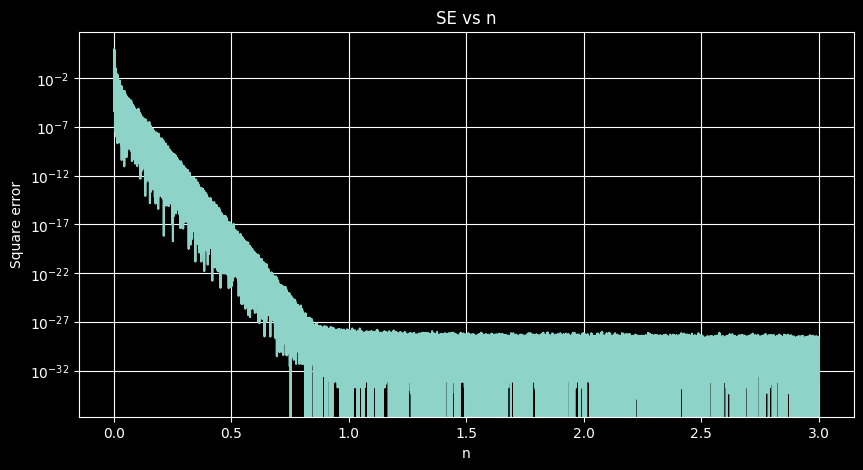

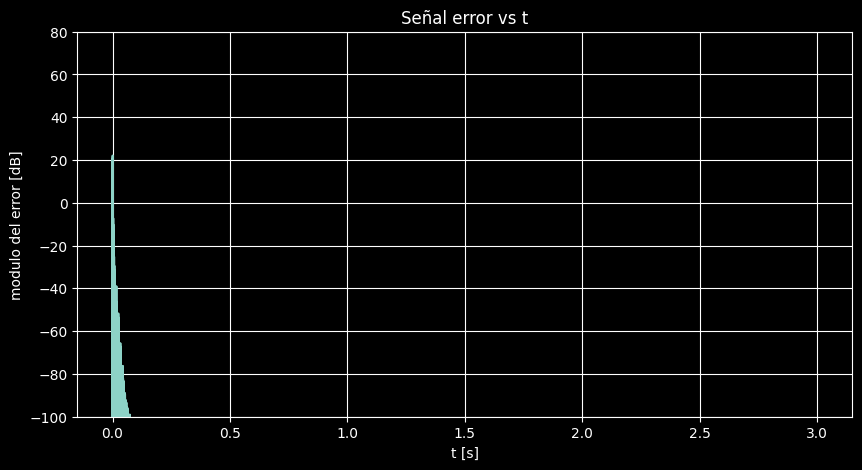

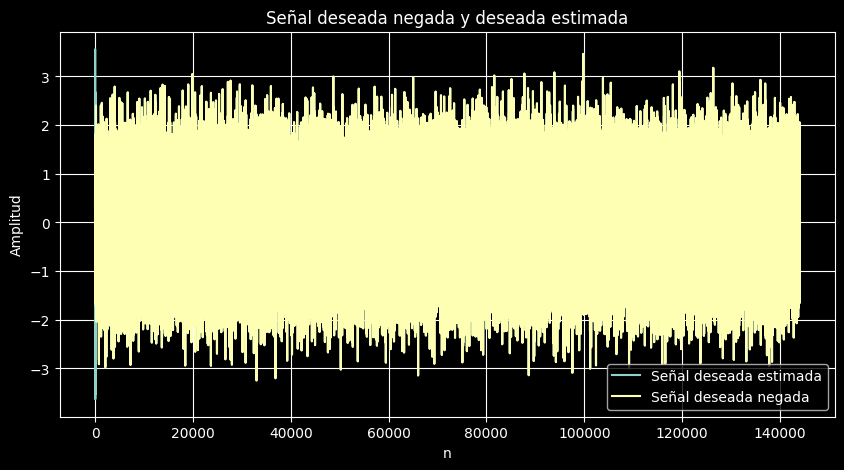

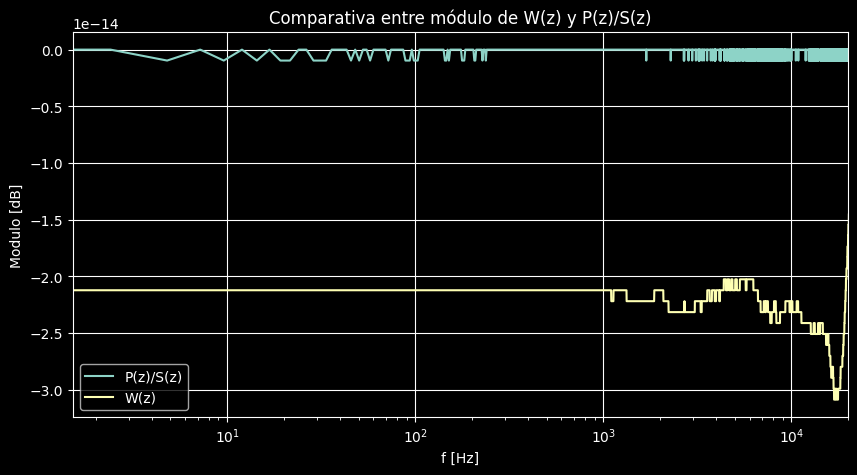

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound)

## Zona de silencio con ruido blanco

En el siguiente bloque se formo una zona de silencio que elimina interferencias de ruido blanco. Se utilizo el mismo sistema para P y S, siendo este un filtro FIR pasabajos con frecuencia de corte en 15kHz.

Para un w de orden 10, se puede ver que el primer termino de este converge a -1, y los demas a 0. Este es un ejemplo de juguete. Este y el que sigue son basicamente lo mismo, pero demuestran los problemas de convergencia cuando el filtro S te mata partes de la señal. LMS tiene el mismo problema, si la señal de entrada no exita todas las bandas, el algoritmo le cuesta mas converger en esas bandas donde la exitacion tiene menos potencia. En este caso se ve con la banda despues de 15Khz. Es como agregar un costo no uniforme en para la convergencia. Mirar Adaptive Signal Processing, Widrow, pagina 218.

In [ ]:
x = lambda n: np.random.normal(0, 2, size=len(n))

sound = lambda n: 0

w_order = 10
wi = np.zeros(w_order)
mu = 0.5
# FIR orden 50 con f de corte en 15KHz
P = ([0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,   \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )


S = ([ 0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,  \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )

S_hat = S

results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)


IntProgress(value=0, max=384000)

5.819160780519408e-25

<StemContainer object of 3 artists>

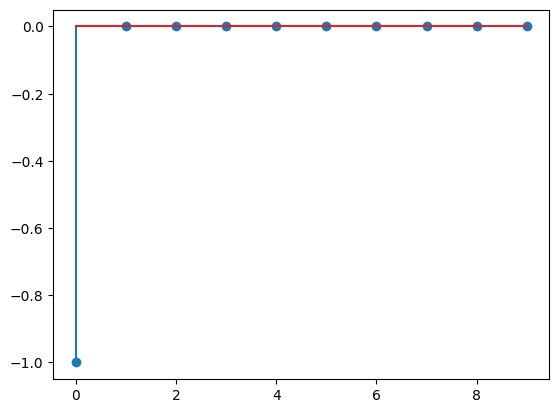

In [ ]:
plt.figure()
plt.stem(results[0])

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

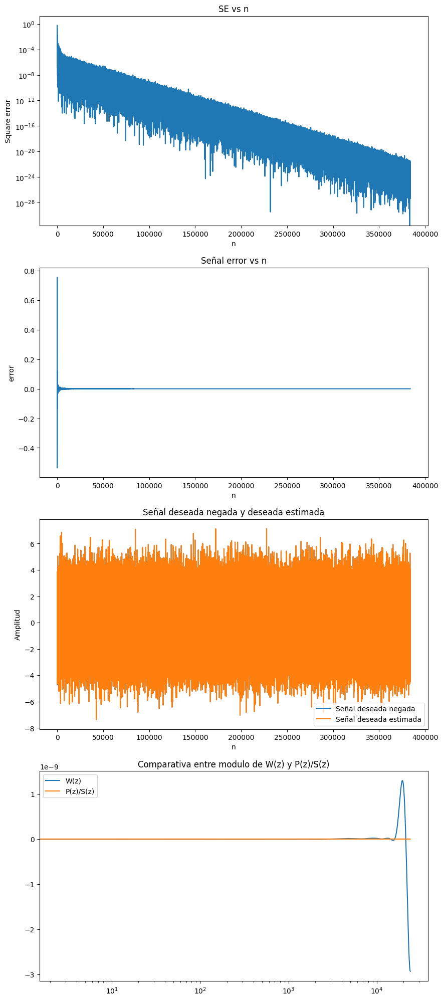

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound)

Mismo sistema que antes pero con ruido de calle

In [ ]:
x = lambda n: Street[0][n]

sound = lambda n: 0

w_order = 10
wi = np.zeros(w_order)
mu = 0.1
P = ([0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,  \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )


S = ([ 0.25710141,  0.56759341,  0.36275683, -0.14074494, -0.16174654,  \
        0.12823306,  0.05811698, -0.11620306,  0.01515356,  0.08046367, \
       -0.05774555, -0.02982777,  0.06513562, -0.0166772 , -0.04321455, \
        0.04235021,  0.00806632, -0.0412385 ,  0.02130754,  0.02045124, \
       -0.03241952,  0.00518836,  0.02412965, -0.02152481, -0.00541805, \
        0.02237718, -0.01142921, -0.01095489,  0.01772157, -0.00348454, \
       -0.01262484,  0.0122324 ,  0.00174199, -0.01165468,  0.00714404, \
        0.0045253 , -0.00938547,  0.00326163,  0.00533944, -0.00672168, \
        0.00069973,  0.00497453, -0.00439681, -0.00061501,  0.00400033, \
       -0.00263338, -0.00110586,  0.00297181, -0.00153013, -0.00108514], [1] )

S_hat = S
N = 100000
x_test = x(N)
xf = sp.lfilter(S[0], S[1], Street[0][:N])
N = len(xf)
R = sp.correlate(xf, xf)/N
R = R[N-w_order: N][::-1]
matR = linalg.toeplitz(R)
lambdas, _= linalg.eig(matR)

sigmaS = np.sum(np.array(S[0])**2)
k = np.arange(len(S[0]))
tauS = np.sum(k*np.array(S[0])**2)
deltaEq = tauS/sigmaS

lamdaRLS =np.exp(-1/fs*30e-3) # 0.999306
deltaRLS = np.var(xf) * (1-lamdaRLS)
print("Delta RLS: ", deltaRLS)
mu = 1/(np.var(xf)*(w_order + 2*deltaEq))

#results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)
results = hp.fxrls_sim(lamdaRLS, deltaRLS, P, S, S_hat, x, sound, w_order, w_order + 50, N = fs*3)


Delta RLS:  8.827251201789865e-10


IntProgress(value=0, max=144000)

4.346608206488247e-22

<StemContainer object of 3 artists>

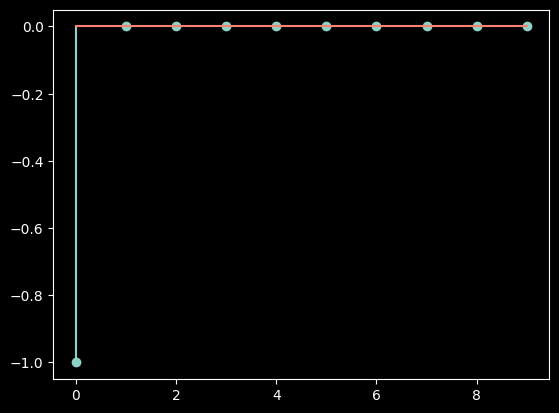

In [ ]:
plt.figure()
plt.stem(results[0])

/home/gullino18/Documents/github/PASA_Proyecto2/helper.py:215: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  plt.xlim([0,20000])


'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

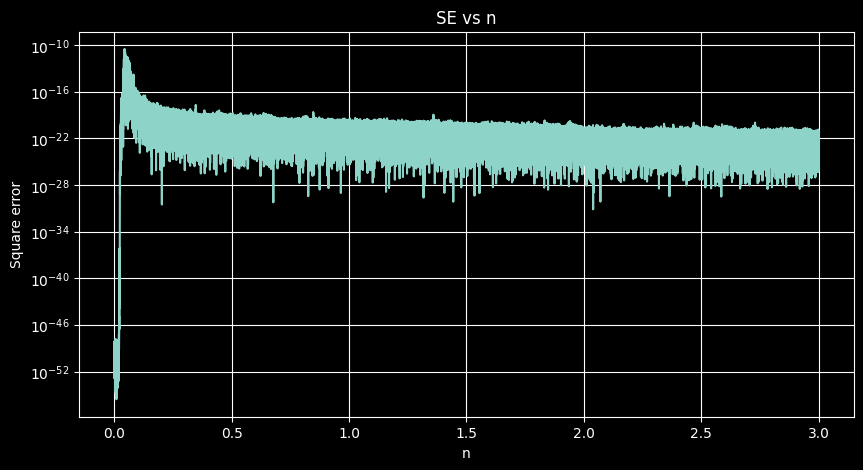

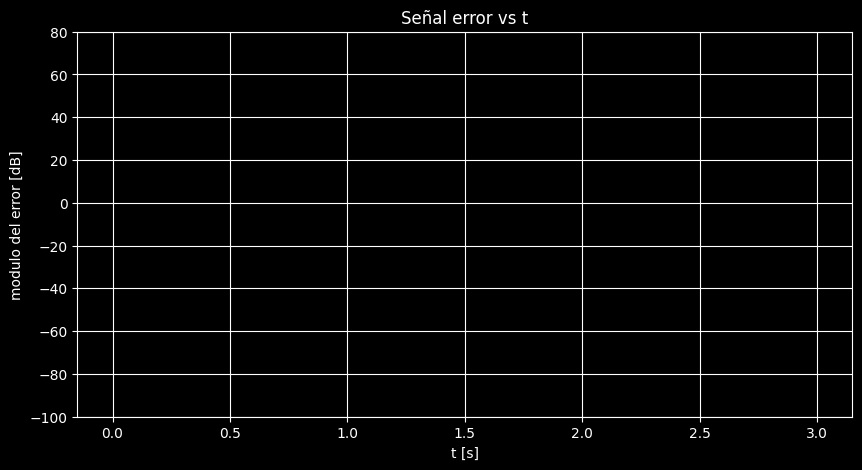

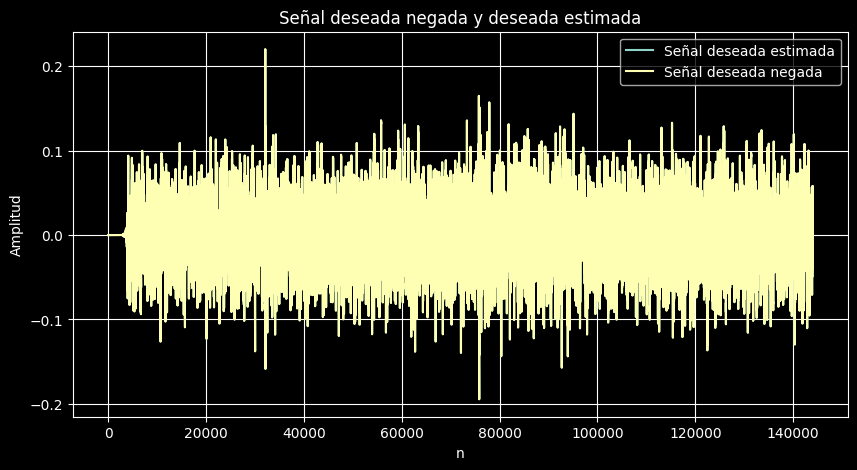

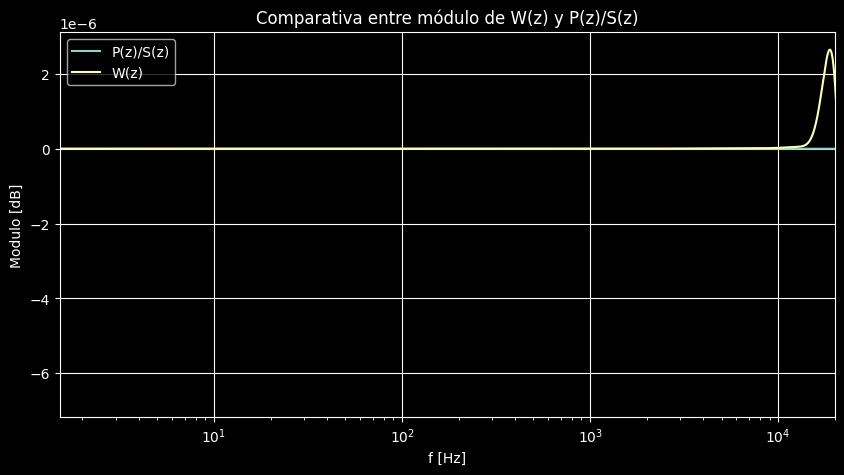

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound)

Ahora se utiliza la respuesta del auricular. Con este ejemplo se espera probar el funcionamiento preliminar del algoritmo. Estaria bueno verificar el mu, y para hacerlo hay que cambiar el FXNLMS por FXLMS. Al margen de esto, esto solo demuestra convergencia.

In [ ]:
x = lambda n: np.random.normal(0, 1, size=len(n))

sound = lambda n: 0

w_order = 1000
wi = np.zeros(w_order)
mu = 0.005
P = [acousticPaths[4], [1]]

S = [acousticPaths[0], [1]]

S_hat = S

results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)

IntProgress(value=0, max=384000)

0.015800068278447037

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

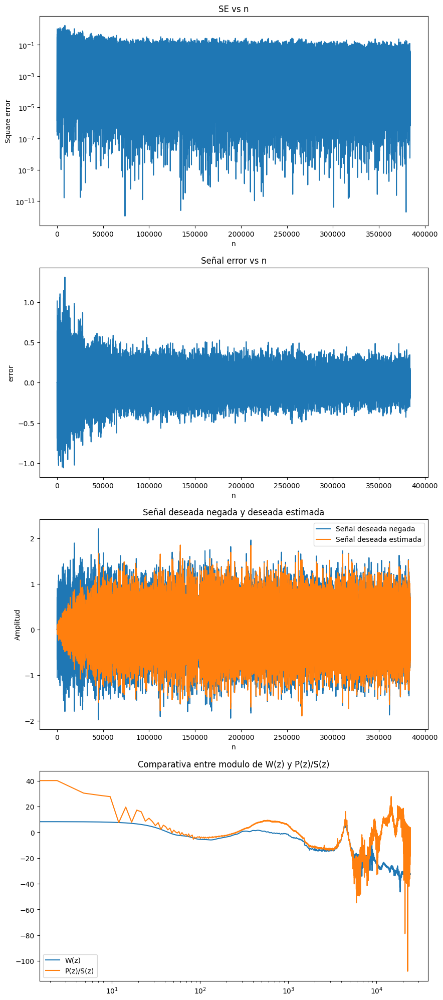

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound)

Mismo que antes solo que ahora se usa como S_hat uan aproximacion FIR hecha con la ecuacion del filtro optimo de wiener. En este ejemplo se demuestra que la reduccion del orden de S_hat no cambio casi nada los resultados. Es algo mas simbolico y heuristico. No se como presentarlo bien.

In [ ]:
x = lambda n: np.random.normal(0, 1, size=len(n))

sound = lambda n: 0

w_order = 1000
wi = np.zeros(w_order)

P = [acousticPaths[4], [1]]
S = [acousticPaths[0], [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 100)

S_hat = [wo, [1]]


results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)

IntProgress(value=0, max=384000)

0.0005513421034974725

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

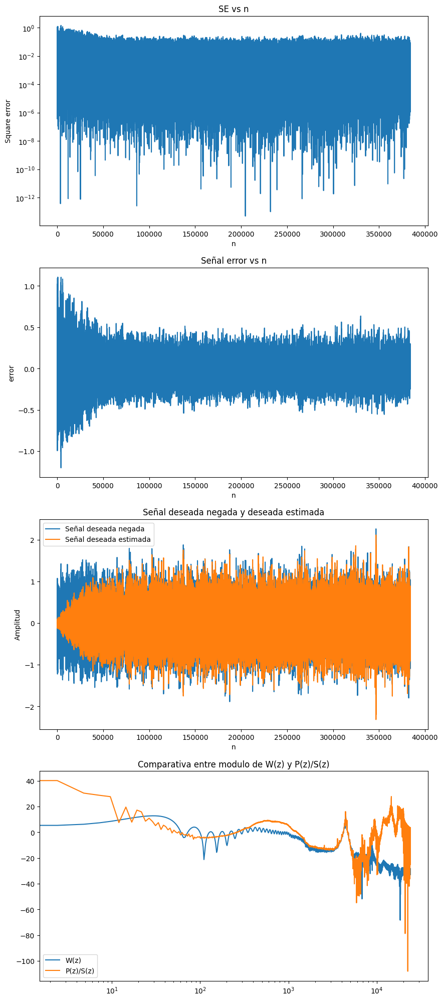

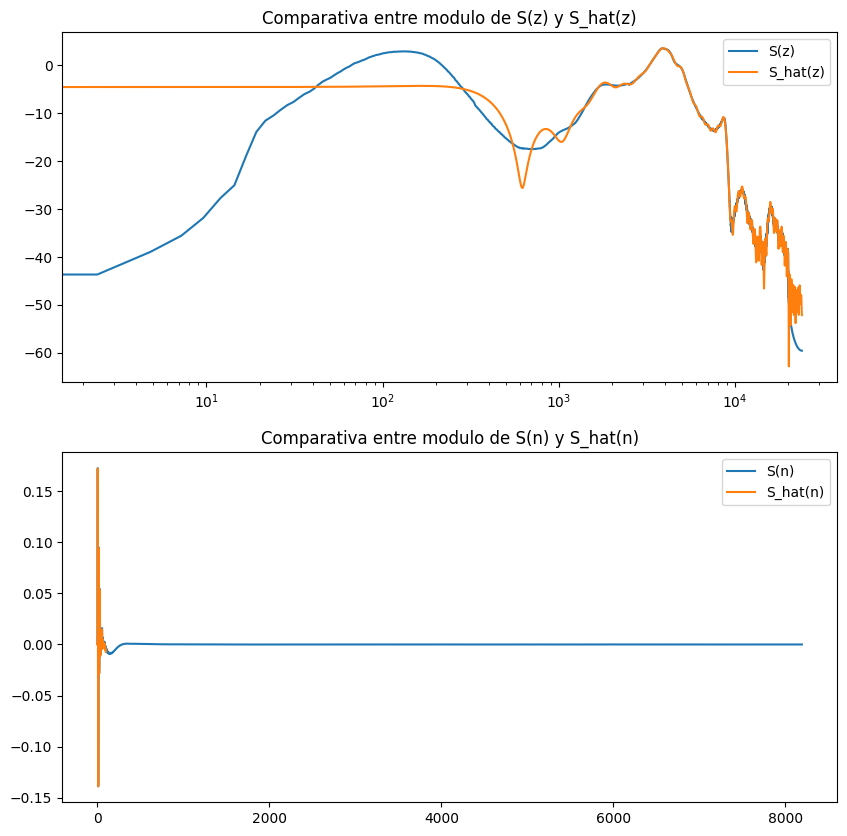

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)

Aca estan las primeras puebas con el cuarto simulado de PyRoom. En particular esto es una zona de silencio como el caso anterior. Es mas que nada una prueba para encontrar el Mu empiricamente. Mismo que antes, calcular el Mu optimo seria bueno (recordar cambiar FXNLMS por FXLMS si se hace).

In [ ]:
x = lambda n: np.random.normal(0, 1, size=len(n))

sound = lambda n: 0

w_order = 500
wi = np.zeros(w_order)
mu = 0.0005
P = [Proom, [1]]

S = [Sroom, [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 1000)

S_hat = [wo, [1]]


results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*10)

IntProgress(value=0, max=480000)

4.715979934030673

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

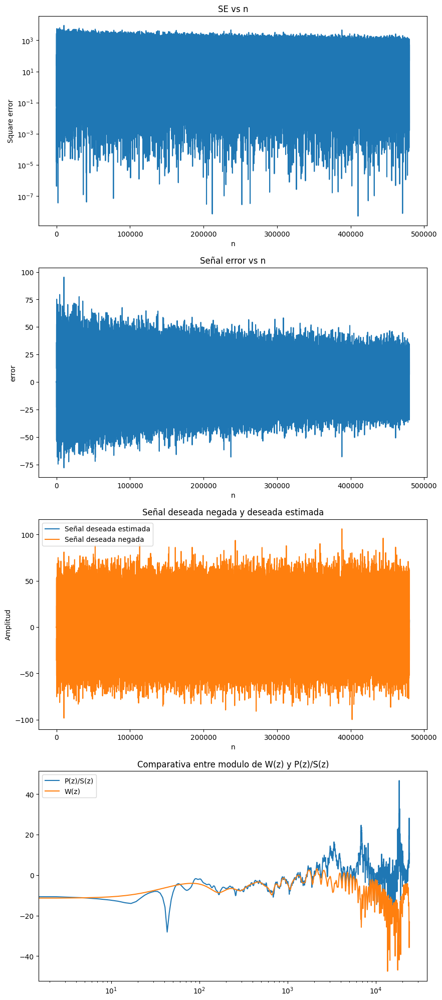

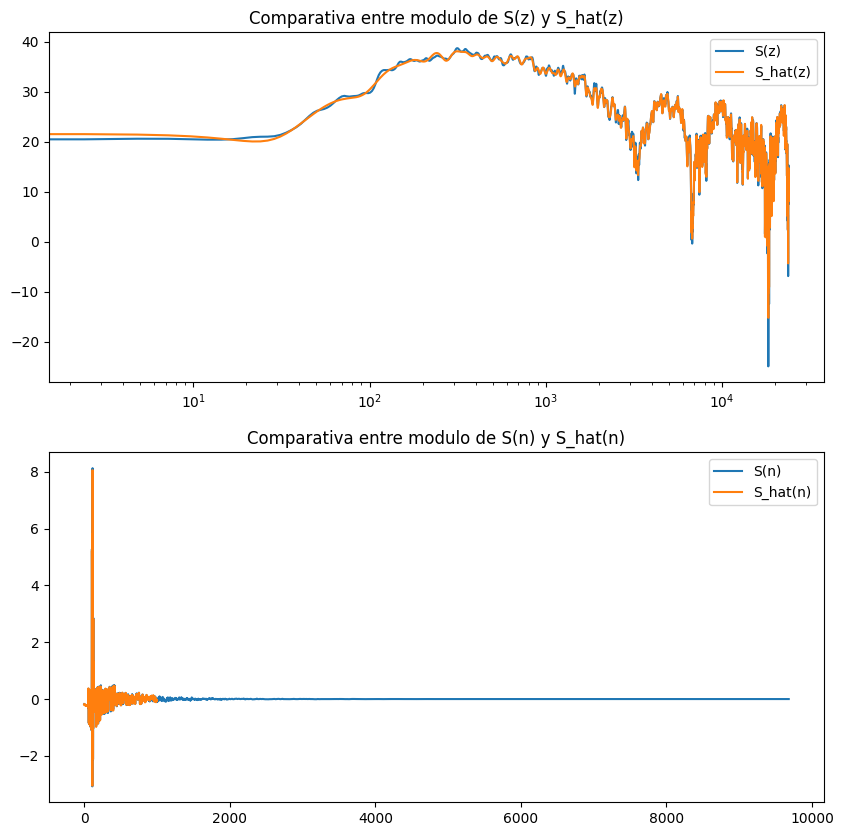

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)

Aca arrancan las pruebas con Voz. En particular demuestran convergencia cuando hay una señal de audio. Estaria bueno calcular el SNR de salida. Para esto, lo que hay que hacer es pasar la musica SOLA por el filtro S y restarselo al error, lo que quede ahi es lo que seria ruido, y es audio que se resto es la señal, el SNR es el cociente de las potencias. Se deberia ver una mejora en el SNR de algunos dBs, no se cuantos

 Justo este anda muy bien


In [ ]:
x = lambda n: np.random.normal(0, 0.1, size=n) if isinstance(n, int) else np.random.normal(0, 0.1, size=len(n))

sound = lambda n: Voice[n]

w_order = 1000
wi = np.zeros(w_order)
mu = 0.001
P = [acousticPaths[4], [1]]

S = [acousticPaths[0], [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 500)

S_hat = [wo, [1]]

N = 100000
x_test = x(N)
xf = sp.lfilter(S[0], S[1], x(N))
N = len(xf)
R = sp.correlate(xf, xf)/N
R = R[N-w_order: N][::-1]
matR = linalg.toeplitz(R)
lambdas, _= linalg.eig(matR)

sigmaS = np.sum(np.array(S[0])**2)
k = np.arange(len(S[0]))
tauS = np.sum(k*np.array(S[0])**2)
deltaEq = tauS/sigmaS

lamdaRLS =np.exp(-1/fs*30e-3) # 0.999306
deltaRLS = np.var(xf) * (1-lamdaRLS)
print("Delta RLS: ", deltaRLS)
mu = 1/(np.var(xf)*(w_order + 2*deltaEq))

#results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)
results = hp.fxrls_sim(lamdaRLS, deltaRLS, P, S, S_hat, x, sound, w_order, w_order + 50, N = fs*3)

Delta RLS:  1.1748335152480806e-09


IntProgress(value=0, max=144000)

3.752298571356535

KeyboardInterrupt: 

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

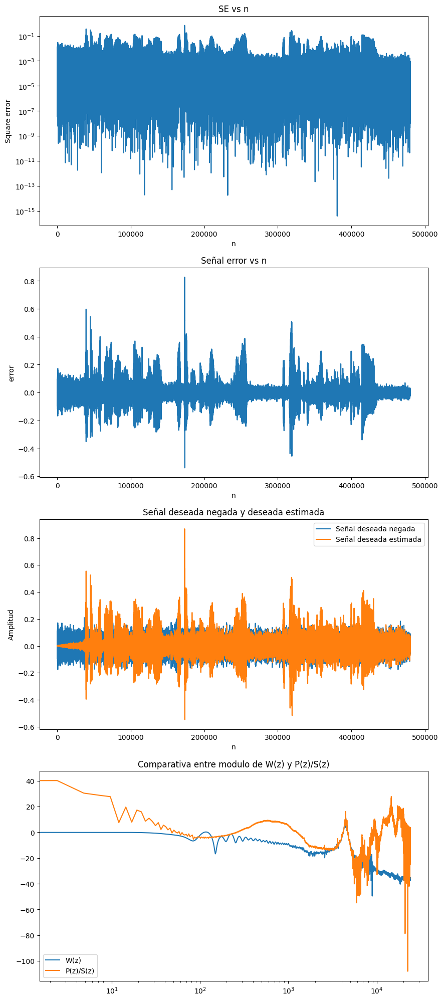

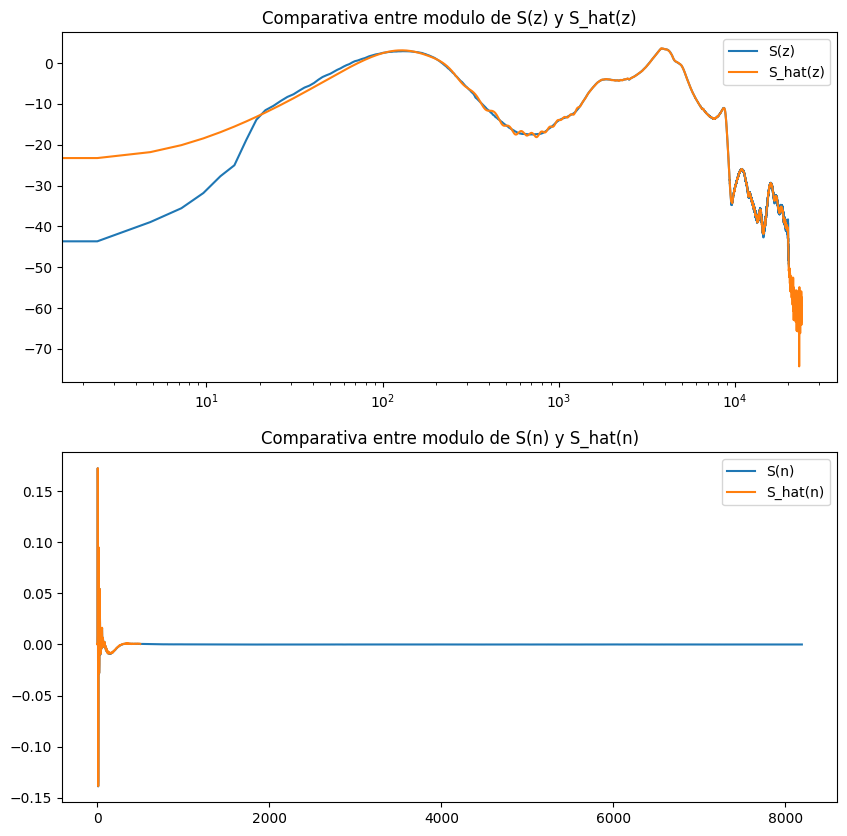

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)

Aca hay que hacer lo mismo que arriba. Ahora que arregle lo de pyroom, anda peor jajaja

In [ ]:
x = lambda n: np.random.normal(0, 1, size=n) if isinstance(n, int) else np.random.normal(0, 1, size=len(n))

sound = lambda n: Voice[n]

w_order = 200
wi = np.zeros(w_order)
mu = 0.005
P = [Proom, [1]]

S = [Sroom, [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 1000)

S_hat = [wo, [1]]


N = 100000
x_test = x(N)
xf = sp.lfilter(S[0], S[1], x(N))
N = len(xf)
R = sp.correlate(xf, xf)/N
R = R[N-w_order: N][::-1]
matR = linalg.toeplitz(R)
lambdas, _= linalg.eig(matR)

sigmaS = np.sum(np.array(S[0])**2)
k = np.arange(len(S[0]))
tauS = np.sum(k*np.array(S[0])**2)
deltaEq = tauS/sigmaS

lamdaRLS =np.exp(-1/fs*30e-3) # 0.999306
deltaRLS = np.var(xf) * (1-lamdaRLS)
print("Delta RLS: ", deltaRLS)
mu = 1/(np.var(xf)*(w_order + 2*deltaEq))

#results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*8)
results = hp.fxrls_sim(lamdaRLS, deltaRLS, P, S, S_hat, x, sound, w_order, w_order + 50, N = fs*3)

Delta RLS:  0.0002826060861906223


IntProgress(value=0, max=144000)

197.86084799948424

/home/gullino18/Documents/github/PASA_Proyecto2/helper.py:215: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  plt.xlim([0,20000])


'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

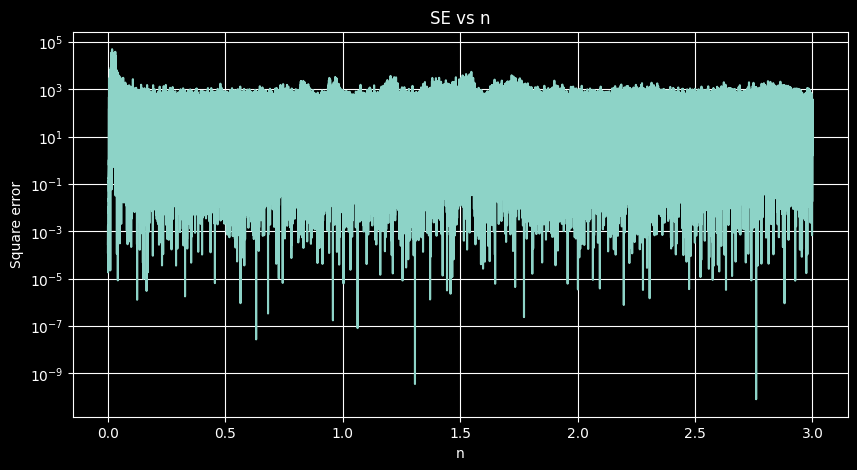

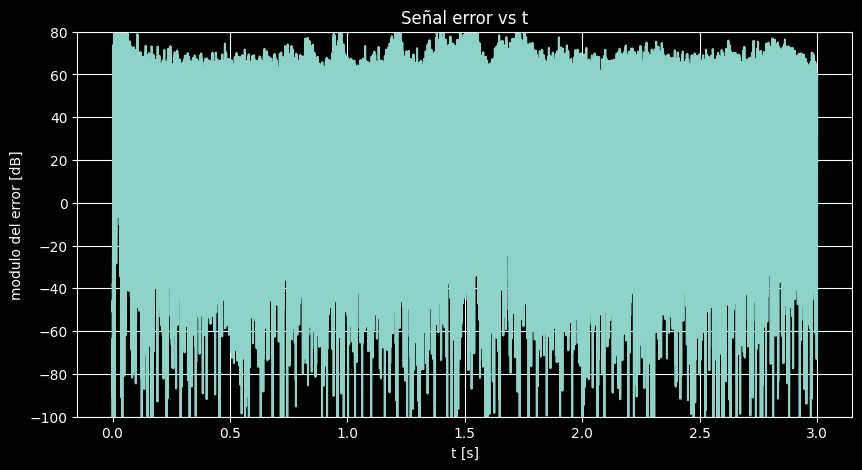

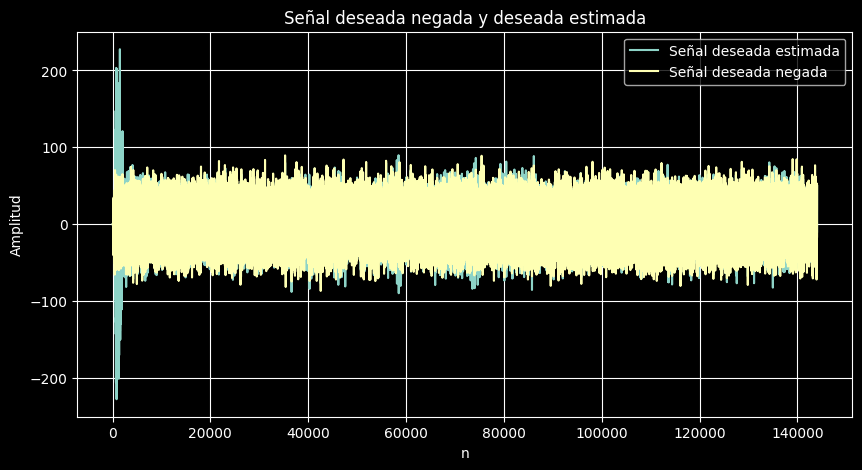

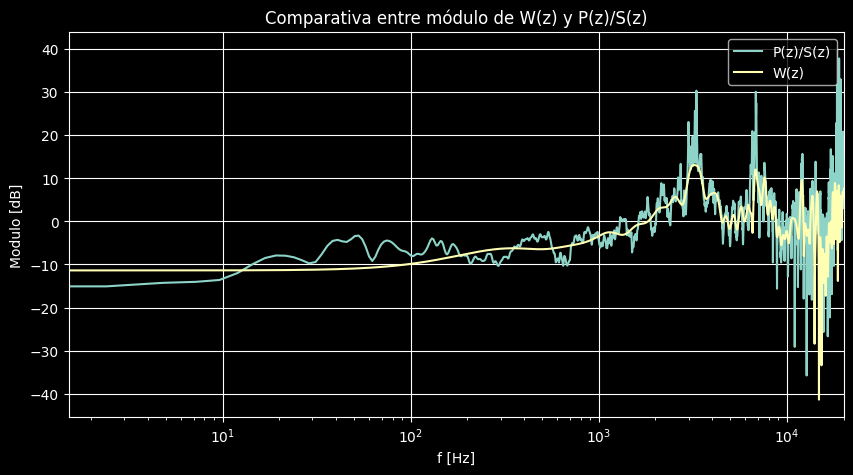

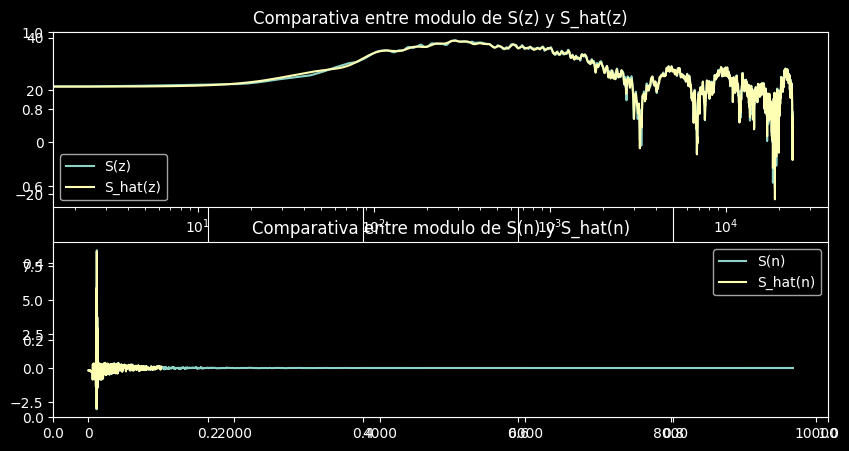

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)

Aca es una situacion mas real, el ruido de interferencia es de la calle, y lo que quiero reproducir es mi voz. Funciona bastante bien

In [ ]:
x = lambda n: Street[0][n]

sound = lambda n: Voice[n]*0.3

w_order = 100
wi = np.zeros(w_order)
mu = 0.01
P = [Proom, [1]]

S = [Sroom, [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 1000)

S_hat = [wo, [1]]


results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*10)

IntProgress(value=0, max=480000)

0.18331991114170781

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

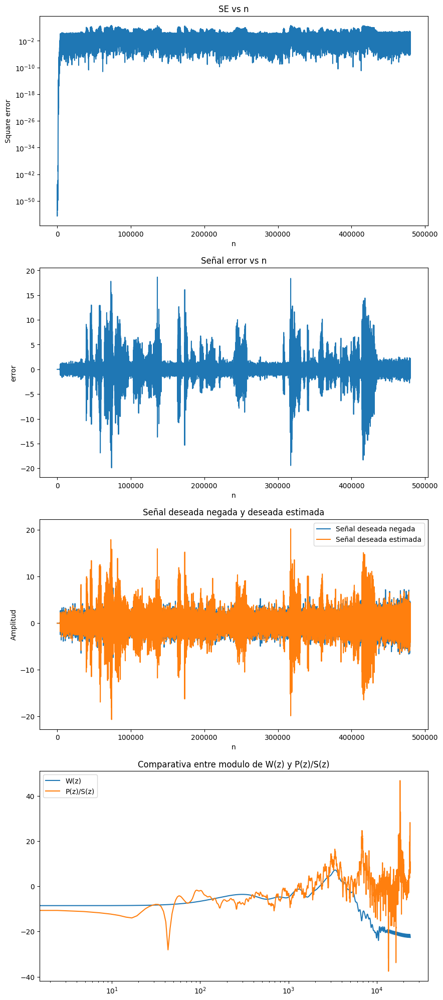

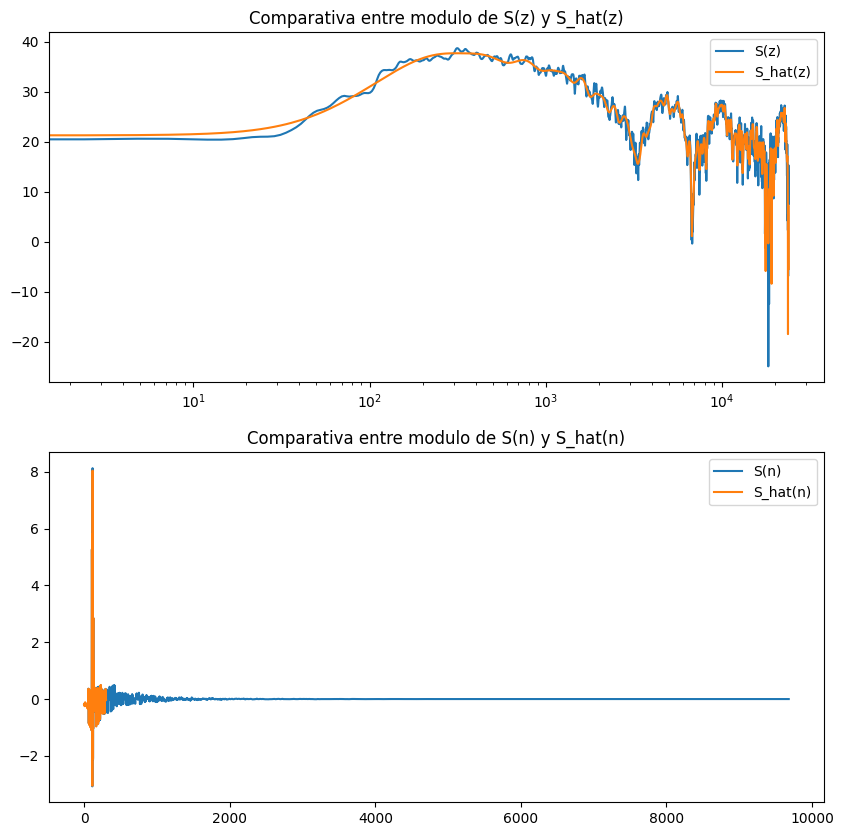

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)

Igual q antes pero con musica

In [ ]:
x = lambda n: Street[0][n]

sound = lambda n: Song[0][n]*0.1

w_order = 100
wi = np.zeros(w_order)
mu = 0.01
P = [Proom, [1]]

S = [Sroom, [1]]

x_vals = np.random.normal(0, 1, size=10000)
y = sp.lfilter(S[0], S[1], x_vals)
wo, _, _ = hp.get_optimal_params(x_vals, y, 300)

S_hat = [wo, [1]]


results = hp.fxnlms_sim(wi, mu, P, S, S_hat, x, sound, w_order, N = fs*10)

IntProgress(value=0, max=480000)

0.3429533187424941

'Señal error:'

'Señal interferencia:'

'Señal interferencia + sonido:'

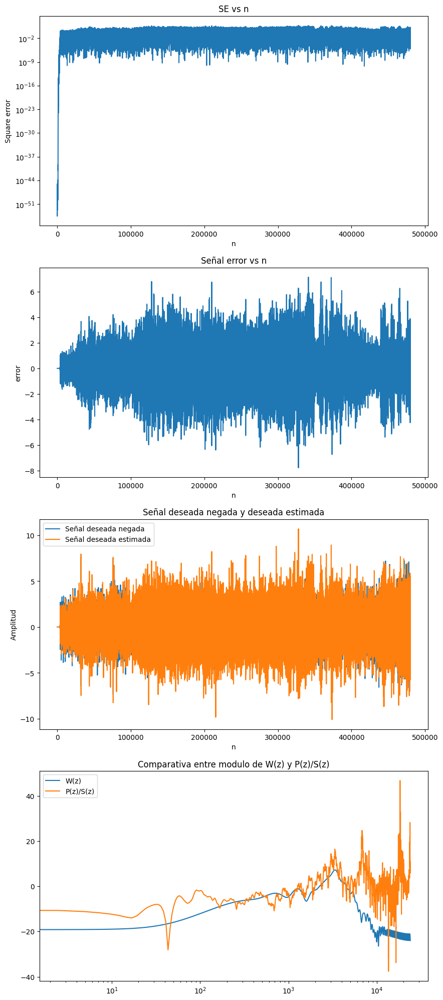

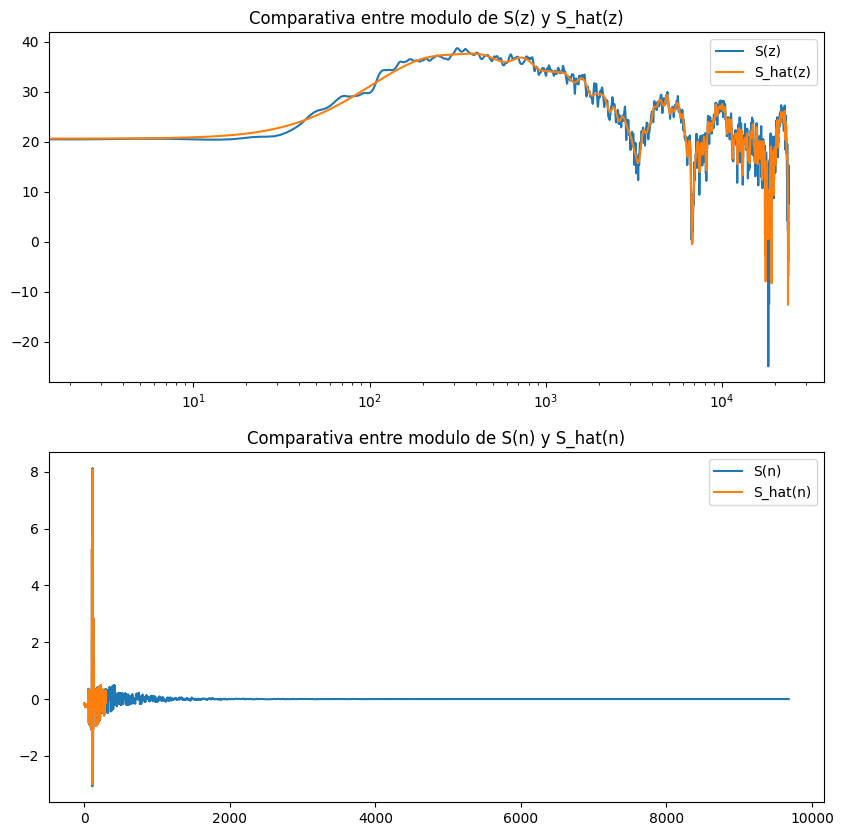

In [ ]:
hp.plot_results(results, P, S, S_hat, x, sound, compare_S_Shat=True)